In [3]:
import os
import re
import numpy as np
from collections import defaultdict
from tqdm import tqdm


In [4]:
def load_captions(captions_file):
    image_captions = defaultdict(list)
    with open(captions_file, 'r') as f:
        for line in f:
            img_id, caption = line.strip().split('\t')
            img_id = img_id.split('#')[0]
            caption = caption.lower()
            caption = re.sub(r'[^a-z0-9\s]', '', caption)  # remove punctuation
            image_captions[img_id].append(caption)
    return image_captions


In [5]:
def build_vocab(image_captions, min_freq=1):
    word_counts = defaultdict(int)
    for captions in image_captions.values():
        for caption in captions:
            for word in caption.split():
                word_counts[word] += 1

    # Filter words by min_freq
    vocab = [word for word, count in word_counts.items() if count >= min_freq]
    
    # Add special tokens
    vocab = ['<pad>', '<start>', '<end>', '<unk>'] + sorted(vocab)

    word2idx = {word: idx for idx, word in enumerate(vocab)}
    idx2word = {idx: word for word, idx in word2idx.items()}
    return vocab, word2idx, idx2word


In [6]:
def load_glove_embeddings(glove_file, word2idx, embedding_dim=200):
    embeddings = np.random.uniform(-0.05, 0.05, (len(word2idx), embedding_dim)).astype(np.float32)
    embeddings[word2idx['<pad>']] = np.zeros((embedding_dim,))  # pad vector is zeros
    
    with open(glove_file, 'r', encoding='utf-8') as f:
        for line in tqdm(f, desc="Loading GloVe"):
            values = line.strip().split()
            word = values[0]
            if word in word2idx:
                vector = np.asarray(values[1:], dtype=np.float32)
                embeddings[word2idx[word]] = vector

    return embeddings


In [7]:
captions_file = './output/captions.txt'
glove_file = 'glove.6B.200d.txt'

image_captions = load_captions(captions_file)
vocab, word2idx, idx2word = build_vocab(image_captions)
embedding_matrix = load_glove_embeddings(glove_file, word2idx)


Loading GloVe: 400000it [00:04, 86687.57it/s] 


In [8]:
np.save('glove_embeddings.npy', embedding_matrix)
import pickle
with open('vocab.pkl', 'wb') as f:
    pickle.dump({'word2idx': word2idx, 'idx2word': idx2word}, f)


In [9]:
from torch.nn.utils.rnn import pad_sequence
import torch

# Define special tokens
PAD_TOKEN = "<pad>"
UNK_TOKEN = "<unk>"
START_TOKEN = "<start>"
END_TOKEN = "<end>"

# Ensure these are in your vocab
special_tokens = [PAD_TOKEN, UNK_TOKEN, START_TOKEN, END_TOKEN]
for token in special_tokens:
    if token not in word2idx:
        word2idx[token] = len(word2idx)

pad_idx = word2idx[PAD_TOKEN]
start_idx = word2idx[START_TOKEN]
end_idx = word2idx[END_TOKEN]

# Sample padded caption preprocessing
def tokenize_and_pad(captions_tokenized, max_length):
    padded = []
    for tokens in captions_tokenized:
        tokens = [start_idx] + tokens + [end_idx]
        if len(tokens) < max_length:
            tokens += [pad_idx] * (max_length - len(tokens))
        else:
            tokens = tokens[:max_length]
        padded.append(torch.tensor(tokens, dtype=torch.long))
    return padded


In [10]:
def collate_fn(batch):
    images, captions = zip(*batch)
    captions = tokenize_and_pad(captions, max_length=MAX_LENGTH)
    captions = torch.stack(captions)
    images = torch.stack(images)
    return images, captions


In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import random
from tqdm import tqdm


In [12]:
class CaptionDataset(Dataset):
    def __init__(self, features_dict, image_captions, word2idx, max_len=20):
        self.data = []
        self.word2idx = word2idx
        self.max_len = max_len
        self.features_dict = features_dict

        self.pad_idx = word2idx['<pad>']
        self.unk_idx = word2idx['<unk>']
        self.start_idx = word2idx['<start>']
        self.end_idx = word2idx['<end>']

        for img, captions in image_captions.items():
            if img not in features_dict:
                continue
            for cap in captions:
                # Tokenize and map to indices with fallback to <unk>
                tokens = [self.word2idx.get(w, self.unk_idx) for w in cap.split()]
                token_ids = [self.start_idx] + tokens + [self.end_idx]

                # Truncate and pad
                if len(token_ids) < max_len:
                    token_ids += [self.pad_idx] * (max_len - len(token_ids))
                else:
                    token_ids = token_ids[:max_len]

                self.data.append((img, torch.tensor(token_ids, dtype=torch.long)))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name, caption = self.data[idx]
        features = self.features_dict[img_name]
        return features, caption, img_name


In [13]:
import torch
import torch.nn as nn

class LSTMDecoder(nn.Module):
    def __init__(self, embedding_matrix, hidden_size, vocab_size, embedding_dim=200, feature_dim=4096):
        super(LSTMDecoder, self).__init__()
        self.hidden_size = hidden_size

        self.embed = nn.Embedding.from_pretrained(torch.tensor(embedding_matrix), freeze=False)
        self.img_fc = nn.Linear(feature_dim, embedding_dim)  # to initialize first token embedding
        self.lstm = nn.LSTM(embedding_dim, hidden_size, batch_first=True)
        self.fc_out = nn.Linear(hidden_size, vocab_size)

    def forward(self, image_features, captions):
        embeddings = self.embed(captions)  # (B, T, E)
        img_emb = self.img_fc(image_features).unsqueeze(1)  # (B, 1, E)
        inputs = torch.cat((img_emb, embeddings[:, :-1]), dim=1)  # prepend img vector

        output, _ = self.lstm(inputs)  # (B, T, H)
        logits = self.fc_out(output)  # (B, T, V)
        return logits


In [14]:
def train_model(model, dataloader, criterion, optimizer, device):
    model.train()
    total_loss = 0

    for features, captions,_ in tqdm(dataloader, desc="Training"):
        features, captions = features.to(device), captions.to(device)
        optimizer.zero_grad()
        outputs = model(features, captions)
        loss = criterion(outputs.view(-1, outputs.size(-1)), captions.view(-1))
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    return total_loss / len(dataloader)


In [15]:
def evaluate_model(model, dataloader, criterion, device):
    model.eval()
    total_loss = 0
    with torch.no_grad():
        for features, captions,_ in tqdm(dataloader, desc="Evaluating"):
            features, captions = features.to(device), captions.to(device)
            outputs = model(features, captions)
            loss = criterion(outputs.view(-1, outputs.size(-1)), captions.view(-1))
            total_loss += loss.item()
    return total_loss / len(dataloader)


In [39]:
# Load data
features_dict = torch.load('vgg16_image_features.pt')
image_captions = load_captions('./output/captions.txt')  # from earlier
vocab, word2idx, idx2word = build_vocab(image_captions)
embedding_matrix = np.load('glove_embeddings.npy')

# Dataset & split
dataset = CaptionDataset(features_dict, image_captions, word2idx)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_ds, val_ds = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_ds, batch_size=64, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=64)

# Model, loss, optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTMDecoder(embedding_matrix, hidden_size=50, vocab_size=len(vocab)).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=word2idx['<pad>'])
optimizer = optim.Adam(model.parameters(), lr=5e-3)

train_losses = []
val_losses = []

for epoch in range(10):
    train_loss = train_model(model, train_loader, criterion, optimizer, device)
    val_loss = evaluate_model(model, val_loader, criterion, device)
    
    train_losses.append(train_loss)
    val_losses.append(val_loss)

    print(f"Epoch {epoch+1} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")



Evaluating: 100%|██████████| 63/63 [00:00<00:00, 482.44it/s]


Epoch 1 | Train Loss: 4.4094 | Val Loss: 3.7095


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 456.62it/s]


Epoch 2 | Train Loss: 3.4993 | Val Loss: 3.4612


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 286.17it/s]


Epoch 3 | Train Loss: 3.2480 | Val Loss: 3.3323


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 493.84it/s]


Epoch 4 | Train Loss: 3.0790 | Val Loss: 3.2599


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 363.68it/s]


Epoch 5 | Train Loss: 2.9404 | Val Loss: 3.1974


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 388.50it/s]


Epoch 6 | Train Loss: 2.8321 | Val Loss: 3.1762


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 476.40it/s]


Epoch 7 | Train Loss: 2.7481 | Val Loss: 3.1632


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 336.79it/s]


Epoch 8 | Train Loss: 2.6766 | Val Loss: 3.1552


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 450.01it/s]


Epoch 9 | Train Loss: 2.6168 | Val Loss: 3.1522


Evaluating: 100%|██████████| 63/63 [00:00<00:00, 469.85it/s]

Epoch 10 | Train Loss: 2.5591 | Val Loss: 3.1625


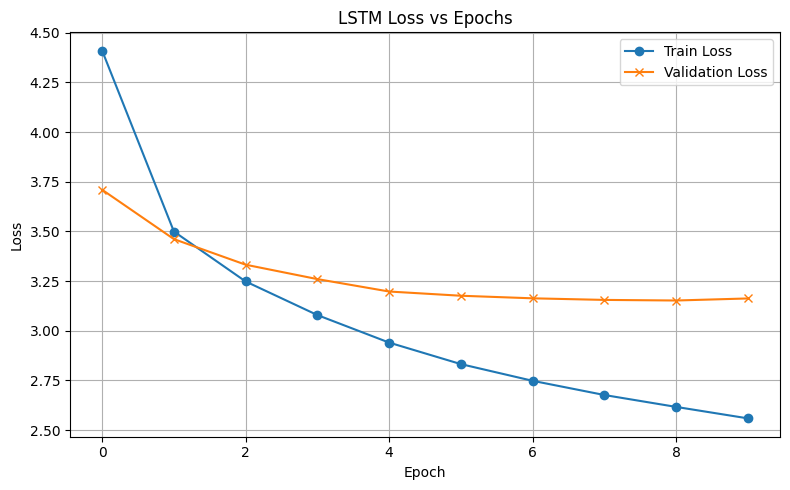

In [40]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.plot(train_losses, label='Train Loss', marker='o')
plt.plot(val_losses, label='Validation Loss', marker='x')
plt.title('LSTM Loss vs Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [30]:
import nltk
from nltk.translate.bleu_score import corpus_bleu
nltk.download('punkt')


[nltk_data] Downloading package punkt to C:\Users\Ashwin
[nltk_data]     Kilingar\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [31]:
def generate_caption(model, feature, word2idx, idx2word, max_len=20):
    model.eval()
    with torch.no_grad():
        feature = feature.unsqueeze(0).to(next(model.parameters()).device)
        img_emb = model.img_fc(feature).unsqueeze(1)
        inputs = img_emb
        hidden = None  # For LSTM, this is a tuple (h, c)
        caption = []

        for _ in range(max_len):
            output, hidden = model.lstm(inputs, hidden)  # hidden = (h, c)
            logits = model.fc_out(output.squeeze(1))
            predicted = logits.argmax(1).item()
            word = idx2word[predicted]

            if word == '<end>':
                break
            if word != '<start>':
                caption.append(word)

            inputs = model.embed(torch.tensor([[predicted]]).to(feature.device))
    return caption


In [32]:
from collections import defaultdict

def load_captions_dict(captions_txt_path):
    captions_dict = defaultdict(list)
    with open(captions_txt_path, 'r') as f:
        for line in f:
            image_tag, caption = line.strip().split('\t')
            image_name = image_tag.split('#')[0]
            captions_dict[image_name].append(caption.strip())
    return captions_dict


In [33]:
from nltk.translate.bleu_score import corpus_bleu
from tqdm import tqdm

def evaluate_bleu(model, dataset, idx2word, captions_dict, word2idx, num_samples=800, max_len=20):
    references = []
    hypotheses = []

    model.eval()
    device = next(model.parameters()).device

    for i in tqdm(range(num_samples), desc="BLEU Evaluation"):
        feature, _, image_name = dataset[i]
        feature = feature.to(device)

        # Get all 5 reference captions for the image
        ref_captions = captions_dict.get(image_name, [])
        ref_tokens = [
            [word.lower() for word in caption.strip().split()]
            for caption in ref_captions if caption.strip()
        ]

        # Generate prediction
        pred_tokens = generate_caption(model, feature, word2idx, idx2word, max_len=max_len)
        pred_tokens = [w.lower() for w in pred_tokens if w not in ['<start>', '<end>', '<pad>']]

        # Only add if both reference and prediction are non-empty
        if len(ref_tokens) > 0 and len(pred_tokens) > 0:
            references.append(ref_tokens)
            hypotheses.append(pred_tokens)

    # If no valid predictions, avoid BLEU calculation
    if len(hypotheses) == 0:
        print("No valid predictions to evaluate BLEU.")
        return

    # Compute BLEU scores
    bleu1 = corpus_bleu(references, hypotheses, weights=(1.0, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))

    print(f"\nBLEU-1: {bleu1:.4f}")
    print(f"BLEU-2: {bleu2:.4f}")
    print(f"BLEU-3: {bleu3:.4f}")
    print(f"BLEU-4: {bleu4:.4f}")


In [34]:
captions_dict=load_captions_dict("./output/captions.txt")
evaluate_bleu(model, val_ds, idx2word,captions_dict, word2idx, num_samples=4000)


BLEU Evaluation: 100%|██████████| 4000/4000 [00:32<00:00, 122.12it/s]



BLEU-1: 0.4172
BLEU-2: 0.2445
BLEU-3: 0.1294
BLEU-4: 0.0697


In [35]:
def generate_and_show_test_examples(model, dataset, idx2word, word2idx, num_examples=5):
    model.eval()
    print("\n=== Sample Caption Generation ===")
    for i in random.sample(range(len(dataset)), num_examples):
        feature, caption_tensor,_ = dataset[i]
        feature = feature.to(next(model.parameters()).device)

        # Generate prediction
        predicted_caption = generate_caption(model, feature, word2idx, idx2word)
        predicted_text = ' '.join(predicted_caption)

        # Ground truth caption (single one from the dataset item)
        true_ids = caption_tensor.tolist()
        true_caption = [idx2word[idx] for idx in true_ids if idx not in [word2idx['<pad>'], word2idx['<start>'], word2idx['<end>']]]
        true_text = ' '.join(true_caption)

        print(f"\nSample {i + 1}")
        print(f"Predicted:   {predicted_text}")
        print(f"Ground Truth: {true_text}")


In [36]:
generate_and_show_test_examples(model, val_ds, idx2word, word2idx, num_examples=5)



=== Sample Caption Generation ===

Sample 1722
Predicted:   a man in a red shirt is standing on a bench and a red and white dog
Ground Truth: a man runs with the football at a professional or collegiate game

Sample 1469
Predicted:   a man in a red shirt is standing on a bench and a red and white dog
Ground Truth: the mother bird looks over her babies

Sample 3200
Predicted:   a dog is running in the snow
Ground Truth: a white dog is running with an orange fence behind him

Sample 3965
Predicted:   a man in a red shirt is standing on a bench and a red and white dog
Ground Truth: child is splashing around in a green and blue pool

Sample 760
Predicted:   a man in a red shirt is standing on a bench and a red and white dog
Ground Truth: two people go down a water slide on a raft


In [41]:
import random
import os
import torch
import matplotlib.pyplot as plt
from PIL import Image
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

def generate_and_show_test_examples(model, dataset, idx2word, word2idx, num_examples=5, image_dir='./output/images/Images'):
    model.eval()
    smooth = SmoothingFunction().method1
    device = next(model.parameters()).device

    print("\n=== Sample Caption Generation ===")

    for i in random.sample(range(len(dataset)), num_examples):
        feature, caption_tensor, image_name = dataset[i]
        feature = feature.to(device)

        # Generate prediction
        predicted_caption = generate_caption(model, feature, word2idx, idx2word)
        predicted_caption = [w.lower() for w in predicted_caption if w not in ['<start>', '<end>', '<pad>']]
        predicted_text = ' '.join(predicted_caption)

        # Ground truth
        true_ids = caption_tensor.tolist()
        ground_truth = [
            idx2word[idx].lower()
            for idx in true_ids
            if idx not in [word2idx['<pad>'], word2idx['<start>'], word2idx['<end>']]
        ]

        # Compute BLEU scores
        reference = [ground_truth]
        candidate = predicted_caption

        bleu1 = sentence_bleu(reference, candidate, weights=(1, 0, 0, 0), smoothing_function=smooth)
        bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)
        bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth)
        bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)

        # Load and display image
        image_path = os.path.join(image_dir, image_name)
        image = Image.open(image_path).convert("RGB")

        # Plot with captions and BLEU scores
        plt.figure(figsize=(8, 5))
        plt.imshow(image)
        plt.axis('off')
        plt.title(
            f"Pred: {predicted_text}\n"
            f"GT: {' '.join(ground_truth)}\n"
            f"BLEU-1: {bleu1:.2f}, BLEU-2: {bleu2:.2f}, BLEU-3: {bleu3:.2f}, BLEU-4: {bleu4:.2f}",
            fontsize=9
        )
        plt.tight_layout()
        plt.show()



=== Sample Caption Generation ===


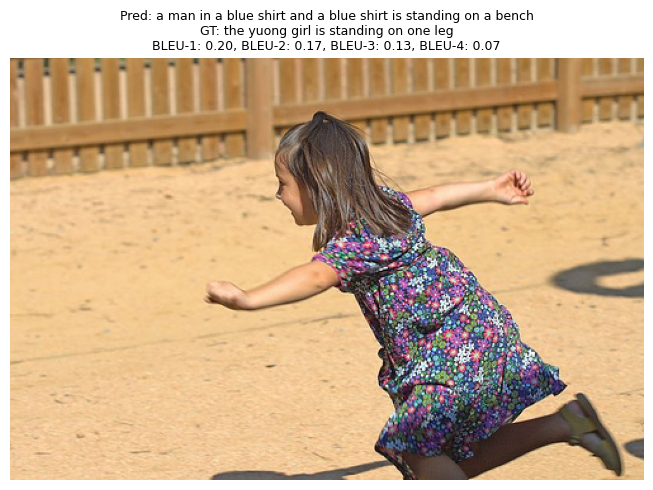

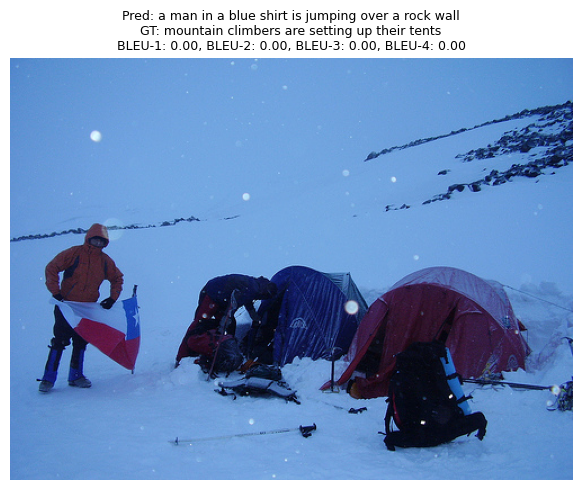

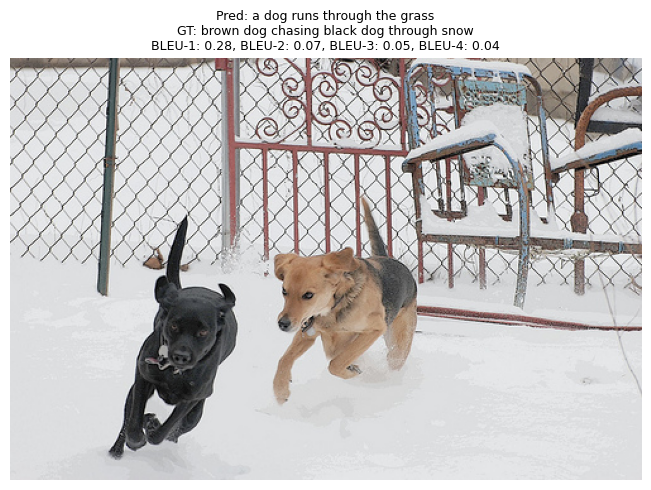

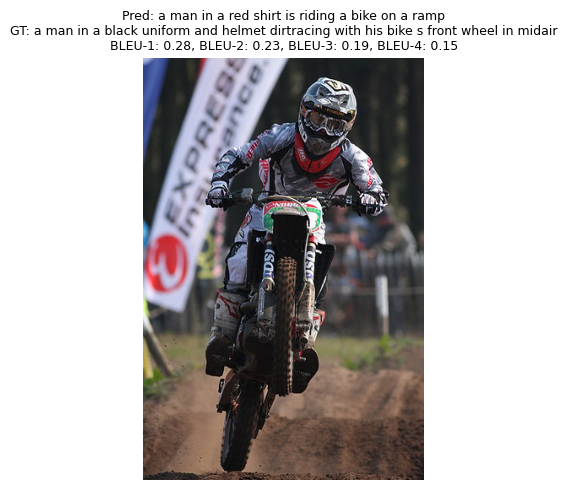

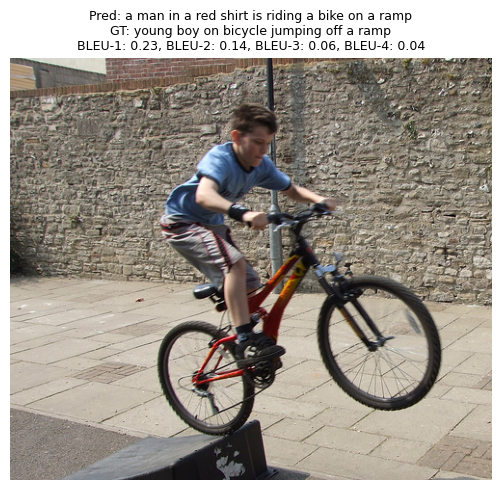

...

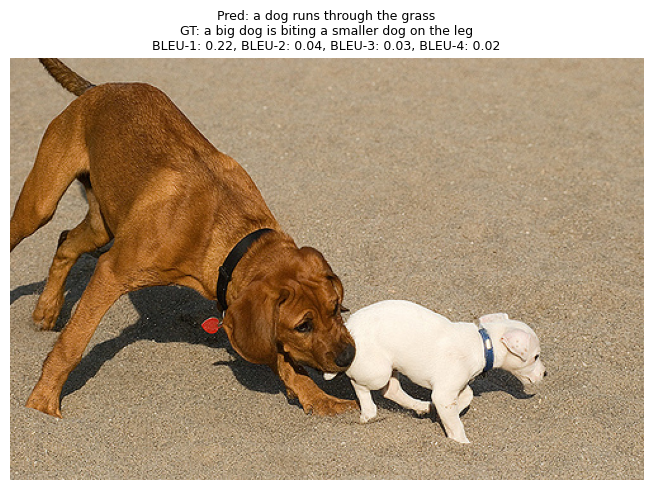

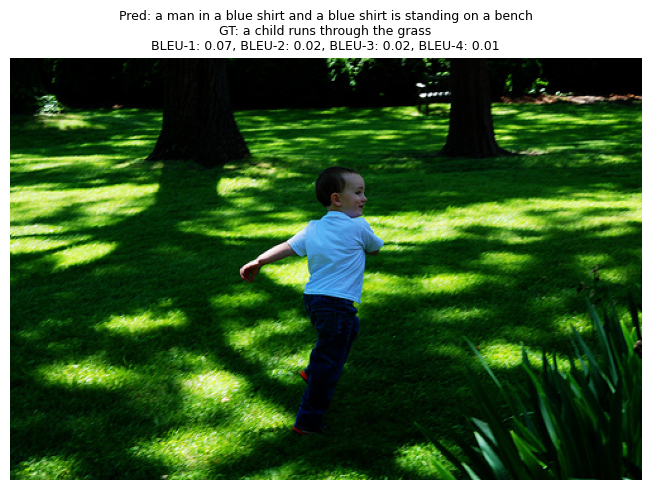

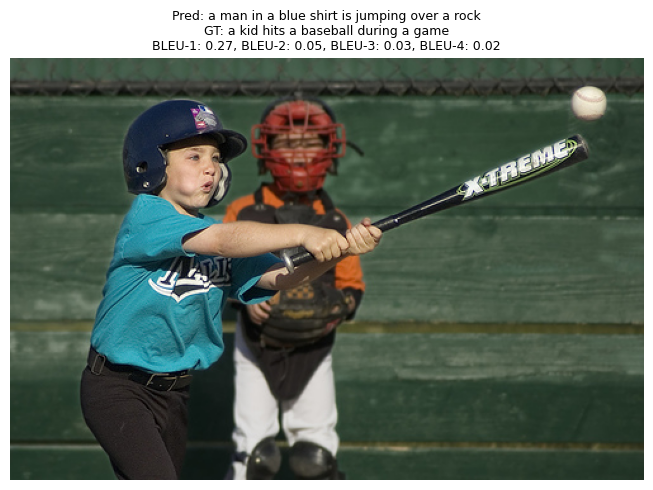

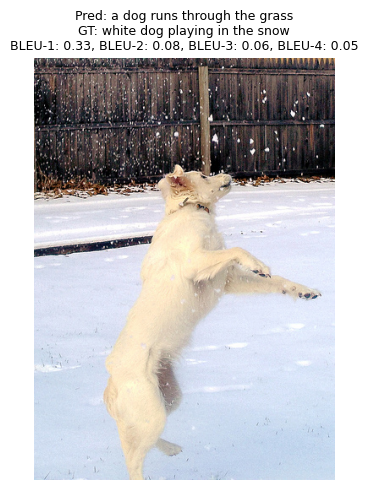

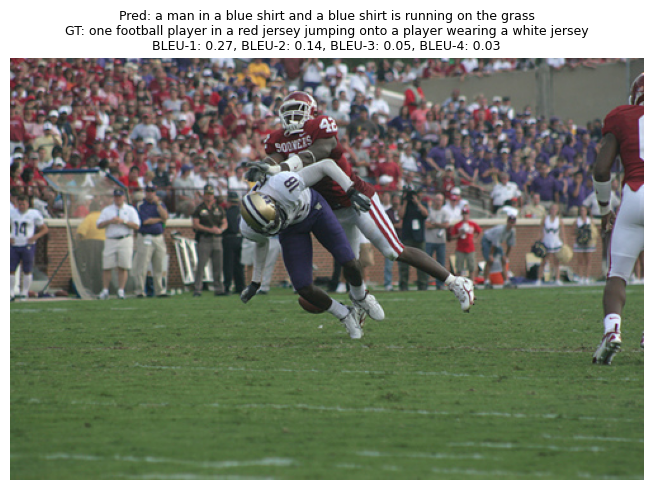

In [43]:
generate_and_show_test_examples(model, val_ds, idx2word, word2idx, num_examples=40)